In [1]:
#import
import pandas as pd
import numpy as np
#dash and plotly
import dash
from dash import dcc
from dash import html
from dash.dependencies import Output, Input
import plotly.express as px
import plotly.graph_objects as go
import plotly.figure_factory as ff
#Models
from sklearn.linear_model import LinearRegression
from sklearn.preprocessing import PolynomialFeatures
from sklearn.pipeline import make_pipeline
from sklearn.metrics import mean_squared_error,r2_score
from sklearn.svm import SVR
from statsmodels.tsa.api import Holt,SimpleExpSmoothing,ExponentialSmoothing
from pmdarima.arima import auto_arima

In [2]:
#Variables
colors = {
    'background': '#171E30',
    'text': '#D0D2D6',
    'cahrtBackground':'#283046',
    'chartPaper' : '#283046',
    'clViolet' : '#675ED6',
    'clBlue' : '#06B7CF',
    'clOrange' : '#DFB66F',
    'clGreen' : '#65FA9E',
    'clRed' : '#D84F51'
    
}

mseList  = np.array(0)
modelNames = np.array(0)

In [3]:
#read database
df = pd.read_csv("owid-covid-data.csv")
apple = pd.read_csv("applemobilitytrends.csv")

C:\Users\ramin\anaconda3\lib\site-packages\IPython\core\interactiveshell.py:3165: DtypeWarning: Columns (3,4) have mixed types.Specify dtype option on import or set low_memory=False.
  has_raised = await self.run_ast_nodes(code_ast.body, cell_name,


In [4]:
#Check covid dataframe 
df.info()
df.location.unique()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 138727 entries, 0 to 138726
Data columns (total 67 columns):
 #   Column                                      Non-Null Count   Dtype  
---  ------                                      --------------   -----  
 0   iso_code                                    138727 non-null  object 
 1   continent                                   129902 non-null  object 
 2   location                                    138727 non-null  object 
 3   date                                        138727 non-null  object 
 4   total_cases                                 130999 non-null  float64
 5   new_cases                                   130994 non-null  float64
 6   new_cases_smoothed                          129954 non-null  float64
 7   total_deaths                                119666 non-null  float64
 8   new_deaths                                  119862 non-null  float64
 9   new_deaths_smoothed                         129954 non-null  float64
 

array(['Afghanistan', 'Africa', 'Albania', 'Algeria', 'Andorra', 'Angola',
       'Anguilla', 'Antigua and Barbuda', 'Argentina', 'Armenia', 'Aruba',
       'Asia', 'Australia', 'Austria', 'Azerbaijan', 'Bahamas', 'Bahrain',
       'Bangladesh', 'Barbados', 'Belarus', 'Belgium', 'Belize', 'Benin',
       'Bermuda', 'Bhutan', 'Bolivia', 'Bonaire Sint Eustatius and Saba',
       'Bosnia and Herzegovina', 'Botswana', 'Brazil',
       'British Virgin Islands', 'Brunei', 'Bulgaria', 'Burkina Faso',
       'Burundi', 'Cambodia', 'Cameroon', 'Canada', 'Cape Verde',
       'Cayman Islands', 'Central African Republic', 'Chad', 'Chile',
       'China', 'Colombia', 'Comoros', 'Congo', 'Cook Islands',
       'Costa Rica', "Cote d'Ivoire", 'Croatia', 'Cuba', 'Curacao',
       'Cyprus', 'Czechia', 'Democratic Republic of Congo', 'Denmark',
       'Djibouti', 'Dominica', 'Dominican Republic', 'Ecuador', 'Egypt',
       'El Salvador', 'Equatorial Guinea', 'Eritrea', 'Estonia',
       'Eswatini', 'Ethi

In [5]:
df.tail()

,iso_code,continent,location,date,total_cases,new_cases,new_cases_smoothed,total_deaths,new_deaths,new_deaths_smoothed,...,female_smokers,male_smokers,handwashing_facilities,hospital_beds_per_thousand,life_expectancy,human_development_index,excess_mortality_cumulative_absolute,excess_mortality_cumulative,excess_mortality,excess_mortality_cumulative_per_million
138722,ZWE,Africa,Zimbabwe,2021-12-04,138523.0,1082.0,669.571,4709.0,1.0,0.714,...,1.6,30.7,36.791,1.7,61.49,0.571,NaN,NaN,NaN,NaN
138723,ZWE,Africa,Zimbabwe,2021-12-05,139046.0,523.0,727.857,4710.0,1.0,0.714,...,1.6,30.7,36.791,1.7,61.49,0.571,NaN,NaN,NaN,NaN
138724,ZWE,Africa,Zimbabwe,2021-12-06,139046.0,0.0,688.571,4710.0,0.0,0.571,...,1.6,30.7,36.791,1.7,61.49,0.571,NaN,NaN,NaN,NaN
138725,ZWE,Africa,Zimbabwe,2021-12-07,141601.0,2555.0,996.571,4713.0,3.0,0.857,...,1.6,30.7,36.791,1.7,61.49,0.571,NaN,NaN,NaN,NaN
138726,ZWE,Africa,Zimbabwe,2021-12-08,150628.0,9027.0,2184.429,4720.0,7.0,1.857,...,1.6,30.7,36.791,1.7,61.49,0.571,NaN,NaN,NaN,NaN


In [6]:
#Check apple dataframe 
apple.info()
apple.head()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4691 entries, 0 to 4690
Columns: 702 entries, geo_type to 2021-12-08
dtypes: float64(696), object(6)
memory usage: 25.1+ MB


,geo_type,region,transportation_type,alternative_name,sub-region,country,2020-01-13,2020-01-14,2020-01-15,2020-01-16,...,2021-11-29,2021-11-30,2021-12-01,2021-12-02,2021-12-03,2021-12-04,2021-12-05,2021-12-06,2021-12-07,2021-12-08
0,country/region,Albania,driving,NaN,NaN,NaN,100.0,95.30,101.43,97.20,...,166.94,152.35,151.20,141.39,163.52,172.67,162.12,156.23,150.23,171.58
1,country/region,Albania,walking,NaN,NaN,NaN,100.0,100.68,98.93,98.46,...,164.26,181.32,224.26,210.36,215.39,214.93,156.72,191.94,208.66,244.65
2,country/region,Argentina,driving,NaN,NaN,NaN,100.0,97.07,102.45,111.21,...,86.90,93.26,100.08,104.56,135.03,146.15,91.97,97.89,128.10,98.74
3,country/region,Argentina,walking,NaN,NaN,NaN,100.0,95.11,101.37,112.67,...,89.50,94.21,99.95,103.63,125.52,123.87,71.43,102.94,122.42,84.15
4,country/region,Australia,driving,AU,NaN,NaN,100.0,102.98,104.21,108.63,...,120.49,128.27,130.51,135.67,143.79,113.66,121.15,124.25,128.52,138.88


In [7]:
#add days since to datbase
basedate = pd.Timestamp('2020-01-01')
df["days_since"] = (pd.to_datetime(df['date']) - basedate).dt.days


In [8]:
#Make different dataframes

#remove null continents (to get countries only)
df1 = df.dropna(subset=['continent'])

#make last day cases by country
last_day_total_cases = df1.groupby(['iso_code'], as_index=False)['new_cases'].sum()


#Worldwide all days
#Make worldwide datbase
worldwide_total = df1.groupby(['date'], as_index=False)['total_cases'].sum()
worldwide_daily_new = df1.groupby(['date'], as_index=False)['new_cases'].sum()
worldwide_daily_deaths = df1.groupby(['date'], as_index=False)['new_deaths'].sum()
worldwide_daily_vaccine = df1.groupby(['date'], as_index=False)['new_vaccinations'].sum()

#add days since to worldwide
basedate = pd.Timestamp('2020-01-01')
worldwide_total["days_since"] = (pd.to_datetime(worldwide_total['date']) - basedate).dt.days






In [9]:
#Filter apple dataset
apple1 = apple.drop(columns=['geo_type', 'alternative_name','sub-region','country'])
apple_us= (apple1[apple1['region'] == 'United States'])
apple_us_drive = apple_us[apple_us['transportation_type']=='driving']
apple_us_drive = (apple_us_drive.drop(columns=['transportation_type','region'])).T
apple_us_drive['date'] = apple_us_drive.index

apple_us_walk = apple_us[apple_us['transportation_type']=='walking']
apple_us_walk = (apple_us_walk.drop(columns=['transportation_type','region'])).T
apple_us_walk['date'] = apple_us_walk.index

apple_us_transit = apple_us[apple_us['transportation_type']=='transit']
apple_us_transit = (apple_us_transit.drop(columns=['transportation_type','region'])).T
apple_us_transit['date'] = apple_us_transit.index


apple_edited = pd.DataFrame()  
apple_edited['date'] = apple_us_drive['date']
apple_edited['drive'] = apple_us_drive.iloc[:, 0]
apple_edited['walk'] = apple_us_walk.iloc[:, 0]
apple_edited['transit'] = apple_us_transit.iloc[:, 0]
apple_edited=apple_edited[apple_edited["date"] > "2020-01-21"]
apple_edited
#filter covid datset for US
us_covid = df1[df1["location"]=="United States"]


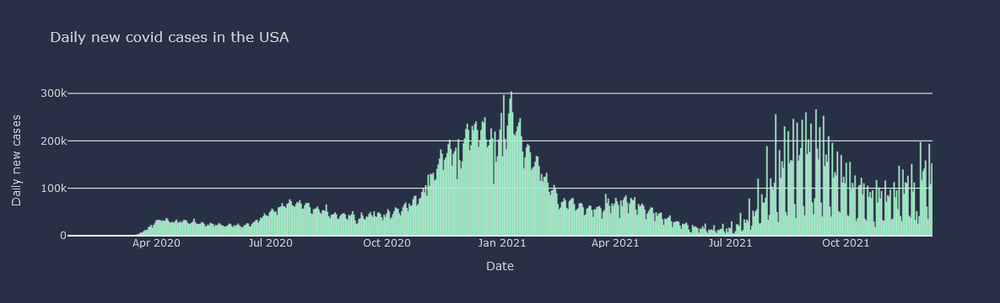

In [10]:
#Apple driving us
apple_drive=go.Figure()
apple_drive.add_trace(go.Bar(
    x=apple_edited['date'],
    y=apple_edited['drive'],
    name='Apple Drive',
    marker_color=colors['clViolet']
))
apple_drive.update_layout(title="Apple mobility trends (driving) in the USA",
                 xaxis_title="Date",yaxis_title="Relative driving volume")
apple_drive.update_layout(
paper_bgcolor=colors['cahrtBackground'],
plot_bgcolor=colors['chartPaper'],
font_color=colors['text'],
title_font_color=colors['text'],
legend_title_font_color=colors['text'])

#Apple walking us
apple_walk=go.Figure()
apple_walk.add_trace(go.Bar(
    x=apple_edited['date'],
    y=apple_edited['walk'],
    name='Apple Walk',
    marker_color=colors['clBlue']
))
apple_walk.update_layout(title="Apple mobility trends (walking) in the USA",
                 xaxis_title="Date",yaxis_title="Relative walking volume")
apple_walk.update_layout(
paper_bgcolor=colors['cahrtBackground'],
plot_bgcolor=colors['chartPaper'],
font_color=colors['text'],
title_font_color=colors['text'],
legend_title_font_color=colors['text'])

#Apple transit us
apple_transit=go.Figure()
apple_transit.add_trace(go.Bar(
    x=apple_edited['date'],
    y=apple_edited['transit'],
    name='Apple transit',
    marker_color=colors['clOrange']
))
apple_transit.update_layout(title="Apple mobility trends (transit) in the USA",
                 xaxis_title="Date",yaxis_title="Relative transit volume")
apple_transit.update_layout(
paper_bgcolor=colors['cahrtBackground'],
plot_bgcolor=colors['chartPaper'],
font_color=colors['text'],
title_font_color=colors['text'],
legend_title_font_color=colors['text'])

#Us Daily Cases
us_daily=go.Figure()
us_daily.add_trace(go.Bar(
    x=us_covid['date'],
    y=us_covid['new_cases'],
    name='US Daily',
    marker_color=colors['clGreen']
))
us_daily.update_layout(title="Daily new covid cases in the USA",
                 xaxis_title="Date",yaxis_title="Daily new cases")
us_daily.update_layout(
paper_bgcolor=colors['cahrtBackground'],
plot_bgcolor=colors['chartPaper'],
font_color=colors['text'],
title_font_color=colors['text'],
legend_title_font_color=colors['text'])

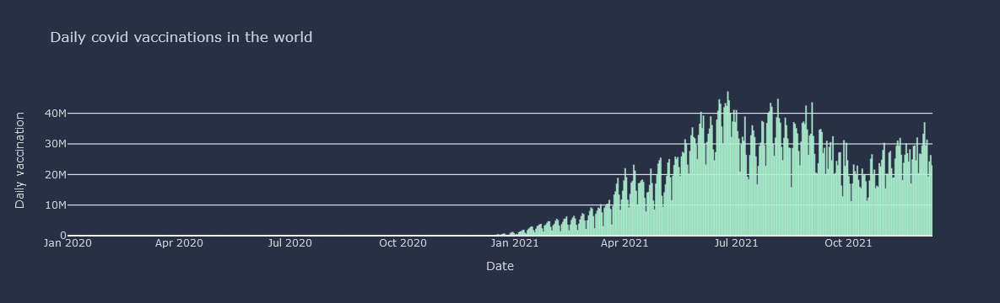

In [11]:
#Worldwide graphs 

#Worldwide total

ww_t_c=go.Figure()
ww_t_c.add_trace(go.Scatter(x=worldwide_total["date"], y=worldwide_total["total_cases"],
                    mode='lines+markers',name="Total cases",
                    line=dict(color=colors['clBlue'], width=4)))
ww_t_c.update_layout(title="Total covid cases in the world",
                 xaxis_title="Date",yaxis_title="Total Cases",legend=dict(x=0,y=1,traceorder="normal"))
ww_t_c.update_layout(
paper_bgcolor=colors['cahrtBackground'],
plot_bgcolor=colors['chartPaper'],
font_color=colors['text'],
title_font_color=colors['text'],
legend_title_font_color=colors['text'])

#Worldwide daily
ww_d_c=go.Figure()
ww_d_c.add_trace(go.Bar(
    x=worldwide_daily_new["date"],
    y=worldwide_daily_new["new_cases"],
    name='New Cases',
    marker_color=colors['clOrange']
))
ww_d_c.update_layout(title="Daily covid cases in the world",
                 xaxis_title="Date",yaxis_title="Daily covid cases")
ww_d_c.update_layout(
paper_bgcolor=colors['cahrtBackground'],
plot_bgcolor=colors['chartPaper'],
font_color=colors['text'],
title_font_color=colors['text'],
legend_title_font_color=colors['text'])

#Worldwide daily deaths
ww_d_d=go.Figure()
ww_d_d.add_trace(go.Bar(x=worldwide_daily_deaths["date"],y=worldwide_daily_deaths["new_deaths"],
    name='New Deaths',marker_color=colors['clRed']
))
ww_d_d.update_layout(title="Daily covid deaths in the world",
                 xaxis_title="Date",yaxis_title="Daily covid deaths")
ww_d_d.update_layout(
paper_bgcolor=colors['cahrtBackground'],plot_bgcolor=colors['chartPaper'],font_color=colors['text'],
title_font_color=colors['text'],legend_title_font_color=colors['text'])

#Worldwide total Vaccinces
ww_t_v=go.Figure()
ww_t_v.add_trace(go.Bar(
    x=worldwide_daily_vaccine["date"],
    y=worldwide_daily_vaccine["new_vaccinations"],
    name='Vaccination',
    marker_color=colors['clGreen']
))
ww_t_v.update_layout(title="Daily covid vaccinations in the world",
                 xaxis_title="Date",yaxis_title="Daily vaccination")
ww_t_v.update_layout(
paper_bgcolor=colors['cahrtBackground'],
plot_bgcolor=colors['chartPaper'],
font_color=colors['text'],
title_font_color=colors['text'],
legend_title_font_color=colors['text'])


In [12]:
#Continent cases
continent = df.groupby(['continent'], as_index=False)['new_cases'].sum()
continent_pop = [1373486472, 4678444992,748962983 ,596581283,43219954,434260137 ]
continent['pop'] =continent_pop
continent['cases_per_pop'] =continent['new_cases']/continent['pop']
continent


,continent,new_cases,pop,cases_per_pop
0,Africa,8784938.0,1373486472,0.006396
1,Asia,81954793.0,4678444992,0.017518
2,Europe,78082793.0,748962983,0.104255
3,North America,59140387.0,596581283,0.099132
4,Oceania,324851.0,43219954,0.007516
5,South America,38942052.0,434260137,0.089674


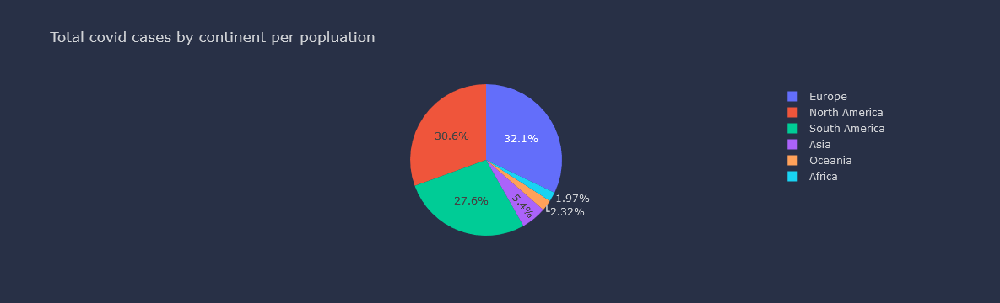

In [13]:
#pie chart

#worldwide
pie_ww_fig = px.pie(continent, values="cases_per_pop", names="continent",
                    title="Total covid cases by continent per popluation",
                   labels={'cases_per_pop':'Total cases per population','continent':'Continents'})
pie_ww_fig.update_layout(
paper_bgcolor=colors['cahrtBackground'],
plot_bgcolor=colors['chartPaper'],
font_color=colors['text'],
title_font_color=colors['text'],
legend_title_font_color=colors['text'])

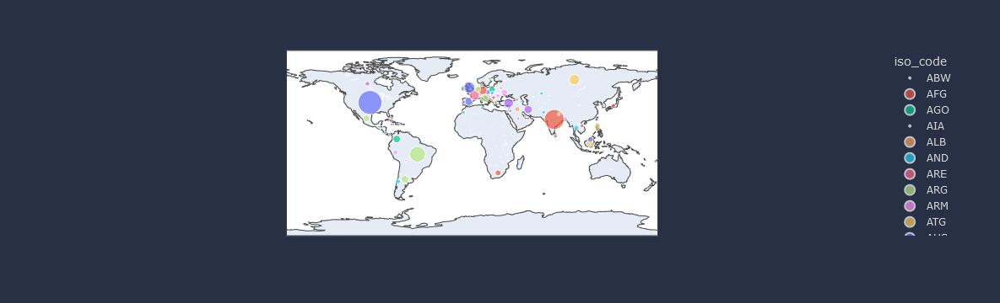

In [14]:
#scatter geo
ww_geo_fig = px.scatter_geo(last_day_total_cases, locations="iso_code",size="new_cases",color = "iso_code",
              
              labels={"date":"Country","new_cases":"Total cases"})
ww_geo_fig.update_layout(
paper_bgcolor=colors['cahrtBackground'],
plot_bgcolor=colors['chartPaper'],
font_color=colors['text'],
title_font_color=colors['text'],
legend_title_font_color=colors['text'])

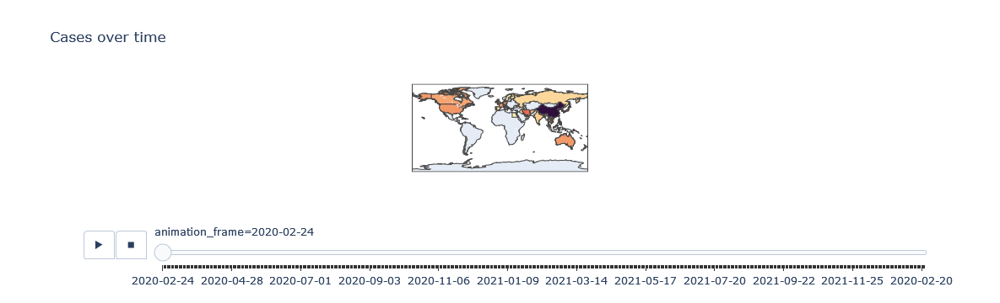

In [15]:
# Over the time
df2 = df1
df2['date'] =pd.to_datetime(df1['date'], errors='coerce')
fig = px.choropleth(df2, locations="location", 
                    color=np.log(df2["total_cases"]),
                    locationmode='country names', hover_name="location", 
                    animation_frame=df2["date"].dt.strftime('%Y-%m-%d'),
                    title='Cases over time', color_continuous_scale=px.colors.sequential.matter)
fig.update(layout_coloraxis_showscale=False)
fig.show()

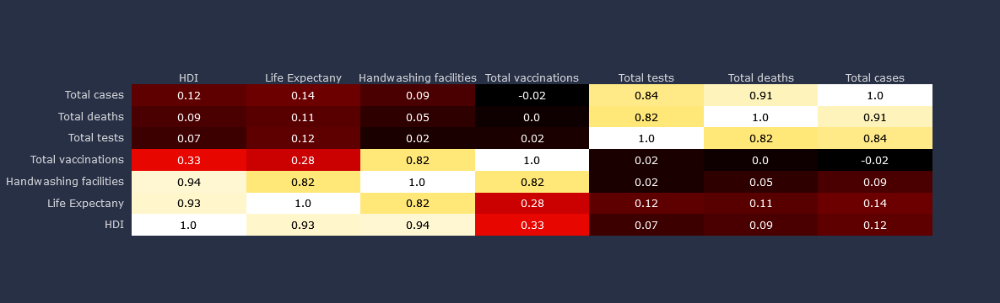

In [16]:
#Correalation between parameters
dfCorr = df1[['total_cases','total_deaths','total_tests','total_vaccinations','handwashing_facilities','life_expectancy','human_development_index']]
cor = dfCorr.iloc[:,:].corr().style.background_gradient(cmap='Reds').format("{:.3f}")
cor2 =dfCorr.iloc[:,:].corr()

corr2Array = cor2.to_numpy().round(decimals=2, out=None)
#labels = ['Total cases', 'Total deaths', 'Total tests','Total vaccinations','Handwashing facilities','Life Expectany','HDI']
labels = ['HDI', 'Life Expectany', 'Handwashing facilities','Total vaccinations','Total tests','Total deaths','Total cases']
fig_cor = ff.create_annotated_heatmap(corr2Array,x=labels,y=labels,colorscale='Hot')
fig_cor.update_layout(
plot_bgcolor = colors['cahrtBackground'],
paper_bgcolor = colors['cahrtBackground'],
font_color=colors['text'])


In [17]:
#data for models
#regression
x_total = np.array(worldwide_total['days_since']).reshape(-1, 1)
y_total = np.array(worldwide_total['total_cases'])
#time series
train_data=worldwide_total.iloc[:int(worldwide_total.shape[0]*0.95)]
valid_data=worldwide_total.iloc[int(worldwide_total.shape[0]*0.95):]

x_train = np.array(train_data['days_since']).reshape(-1, 1)
y_train = np.array(train_data['total_cases'])

x_valid = np.array(valid_data['days_since']).reshape(-1, 1)
y_valid = np.array(valid_data['total_cases'])

Linear MSE is:  24361268.08941122


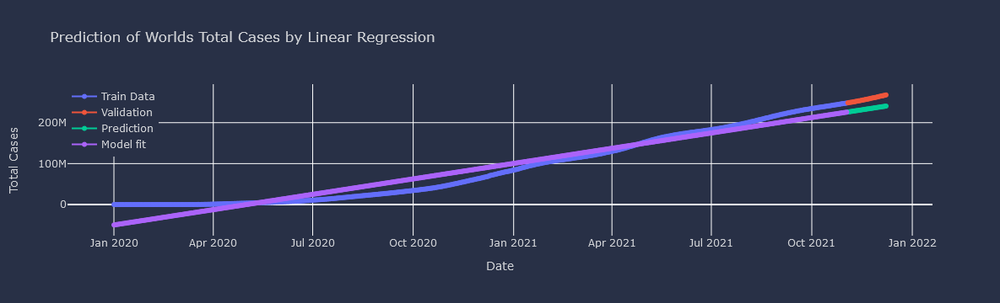

In [18]:
#Liner regression model

#Fit model
linear_reg_WW = LinearRegression().fit(x_train, y_train)
valid_data['linear_pred'] = linear_reg_WW.predict(x_valid)
train_data['linear_pred'] = linear_reg_WW.predict(x_train)
#score
linear_score = np.sqrt(mean_squared_error(valid_data['total_cases'],valid_data['linear_pred']))
mseList =np.append(mseList, linear_score)
modelNames = np.append(modelNames, 'Linear Regression')
print("Linear MSE is: " ,linear_score)
#Draw model and data
#make the graph
fig_ww_line_model_data=go.Figure()
fig_ww_line_model_data.add_trace(go.Scatter(x=train_data["date"], y=train_data["total_cases"],
                    mode='lines+markers',name="Train Data"))
fig_ww_line_model_data.add_trace(go.Scatter(x=valid_data["date"], y=valid_data["total_cases"],
                    mode='lines+markers',name="Validation",))
fig_ww_line_model_data.add_trace(go.Scatter(x=valid_data["date"], y=valid_data["linear_pred"],
                    mode='lines+markers',name="Prediction",))
fig_ww_line_model_data.add_trace(go.Scatter(x=train_data["date"], y=train_data["linear_pred"],
                    mode='lines+markers',name="Model fit",))
fig_ww_line_model_data.update_layout(title="Prediction of Worlds Total Cases by Linear Regression",
                 xaxis_title="Date",yaxis_title="Total Cases",legend=dict(x=0,y=1,traceorder="normal"))
fig_ww_line_model_data.update_layout(
paper_bgcolor=colors['cahrtBackground'],
plot_bgcolor=colors['chartPaper'],
font_color=colors['text'],
title_font_color=colors['text'],
legend_title_font_color=colors['text'])
    


Poly MSE is:  4214937.630807903


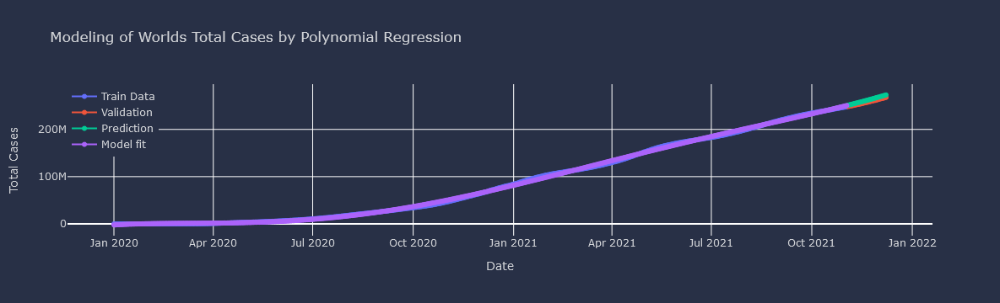

In [19]:
#Polynomial

#making anf fitting
degree=5
polyreg = make_pipeline(PolynomialFeatures(degree),LinearRegression())
polyreg.fit(x_train,y_train)

#prediction
valid_data['poly_pred'] = polyreg.predict(x_valid)
train_data['poly_pred'] = polyreg.predict(x_train)

#score
poly_score = np.sqrt(mean_squared_error(valid_data['total_cases'],valid_data['poly_pred']))
mseList =np.append(mseList, poly_score)
modelNames = np.append(modelNames, 'Polynomial Regression')
print("Poly MSE is: " ,poly_score)

   
#Draw model and data
#make the graph
fig_ww_poly_model_data=go.Figure()
fig_ww_poly_model_data.add_trace(go.Scatter(x=train_data["date"], y=train_data["total_cases"],
                    mode='lines+markers',name="Train Data"))
fig_ww_poly_model_data.add_trace(go.Scatter(x=valid_data["date"], y=valid_data["total_cases"],
                    mode='lines+markers',name="Validation",))
fig_ww_poly_model_data.add_trace(go.Scatter(x=valid_data["date"], y=valid_data["poly_pred"],
                    mode='lines+markers',name="Prediction",))
fig_ww_poly_model_data.add_trace(go.Scatter(x=train_data["date"], y=train_data["poly_pred"],
                    mode='lines+markers',name="Model fit",))
fig_ww_poly_model_data.update_layout(title="Modeling of Worlds Total Cases by Polynomial Regression",
                 xaxis_title="Date",yaxis_title="Total Cases",legend=dict(x=0,y=1,traceorder="normal"))
fig_ww_poly_model_data.update_layout(
paper_bgcolor=colors['cahrtBackground'],
plot_bgcolor=colors['chartPaper'],
font_color=colors['text'],
title_font_color=colors['text'],
legend_title_font_color=colors['text'])


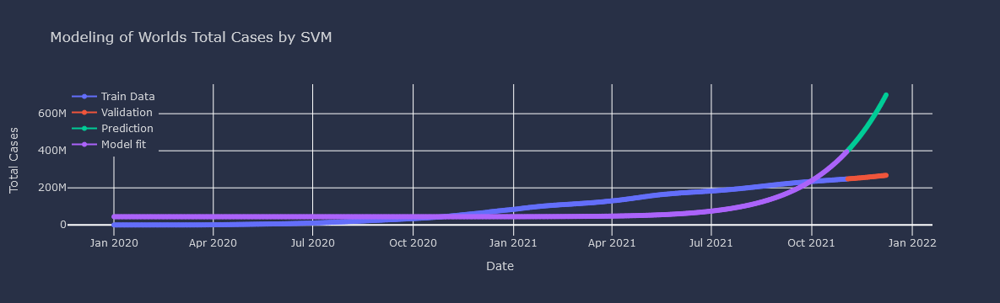

In [20]:
#SVM

#making and fitting the mopdel
svm_degree = 12
svm=SVR(C=1,degree=svm_degree,kernel='poly',epsilon=0.01)
svm.fit(x_train,y_train)

#prediction
valid_data['svm_pred'] = svm.predict(x_valid)
train_data['svm_pred'] = svm.predict(x_train)

#Score
svm_score = np.sqrt(mean_squared_error(valid_data['total_cases'],valid_data['svm_pred']))
#mseList =np.append(mseList, svm_score)
#modelNames = np.append(modelNames, 'SVM')
      
#Draw model and data
#make the graph
fig_ww_svm=go.Figure()
fig_ww_svm.add_trace(go.Scatter(x=train_data["date"], y=train_data["total_cases"],
                    mode='lines+markers',name="Train Data"))
fig_ww_svm.add_trace(go.Scatter(x=valid_data["date"], y=valid_data["total_cases"],
                    mode='lines+markers',name="Validation",))
fig_ww_svm.add_trace(go.Scatter(x=valid_data["date"], y=valid_data["svm_pred"],
                    mode='lines+markers',name="Prediction",))
fig_ww_svm.add_trace(go.Scatter(x=train_data["date"], y=train_data["svm_pred"],
                    mode='lines+markers',name="Model fit",))
fig_ww_svm.update_layout(title="Modeling of Worlds Total Cases by SVM",
                 xaxis_title="Date",yaxis_title="Total Cases",legend=dict(x=0,y=1,traceorder="normal"))
fig_ww_svm.update_layout(
paper_bgcolor=colors['cahrtBackground'],
plot_bgcolor=colors['chartPaper'],
font_color=colors['text'],
title_font_color=colors['text'],
legend_title_font_color=colors['text'])
    



C:\Users\ramin\anaconda3\lib\site-packages\statsmodels\tsa\holtwinters\model.py:427: FutureWarning:

After 0.13 initialization must be handled at model creation



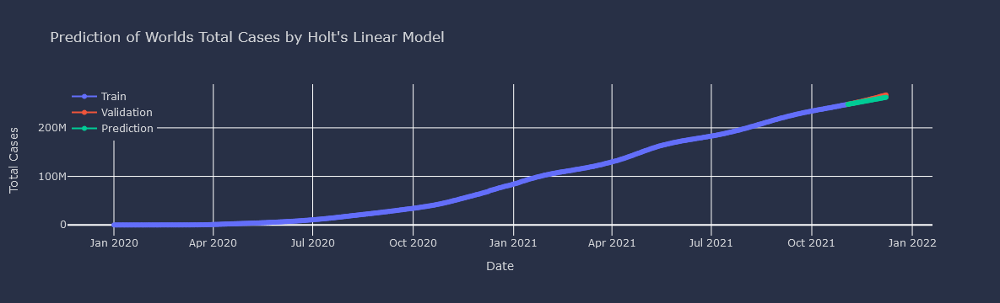

In [21]:
#Holt Model

#Making and fitting
holt = Holt(np.asarray(train_data['total_cases'])).fit(smoothing_level=0.4, smoothing_trend=0.4,optimized=False)     
#prediction
valid_data['holt_pred'] = holt.forecast(len(valid_data))


#Score
holt_score = np.sqrt(mean_squared_error(valid_data['total_cases'],valid_data['holt_pred']))
mseList =np.append(mseList, holt_score)
modelNames = np.append(modelNames, 'Holt')

#graph

fig_holt=go.Figure()
fig_holt.add_trace(go.Scatter(x=train_data["date"], y=train_data["total_cases"],
                    mode='lines+markers',name="Train"))
fig_holt.add_trace(go.Scatter(x=valid_data["date"], y=valid_data["total_cases"],
                    mode='lines+markers',name="Validation",))
fig_holt.add_trace(go.Scatter(x=valid_data["date"], y=valid_data["holt_pred"],
                    mode='lines+markers',name="Prediction",))
fig_holt.update_layout(title="Prediction of Worlds Total Cases by Holt's Linear Model",
                 xaxis_title="Date",yaxis_title="Total Cases",legend=dict(x=0,y=1,traceorder="normal"))
fig_holt.update_layout(
paper_bgcolor=colors['cahrtBackground'],
plot_bgcolor=colors['chartPaper'],
font_color=colors['text'],
title_font_color=colors['text'],
legend_title_font_color=colors['text'])


 ARIMA(0,2,0)(0,0,0)[0] intercept   : AIC=17056.138, Time=0.02 sec
 ARIMA(1,2,0)(0,0,0)[0] intercept   : AIC=17036.830, Time=0.02 sec
 ARIMA(2,2,0)(0,0,0)[0] intercept   : AIC=17026.812, Time=0.05 sec
 ARIMA(3,2,0)(0,0,0)[0] intercept   : AIC=16974.989, Time=0.10 sec
 ARIMA(4,2,0)(0,0,0)[0] intercept   : AIC=16896.429, Time=0.14 sec

Best model:  ARIMA(4,2,0)(0,0,0)[0] intercept
Total fit time: 0.352 seconds


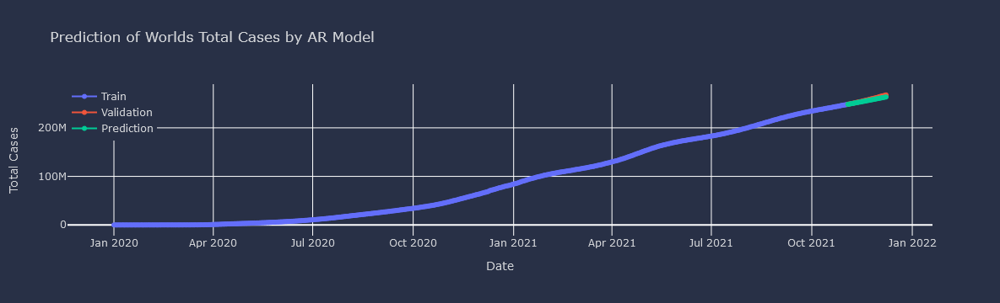

In [22]:
#AR Model (using AUTO ARIMA)

#making and fitting the mopdel
model_ar= auto_arima(train_data['total_cases'],trace=True, error_action='ignore', start_p=0,start_q=0,max_p=4,max_q=0,
                   suppress_warnings=True,stepwise=False,seasonal=False)
model_ar.fit(train_data['total_cases'])

#prediction
valid_data['ar_pred'] = model_ar.predict(len(valid_data))

#Score
ar_score = np.sqrt(mean_squared_error(valid_data['total_cases'],valid_data['ar_pred']))
mseList =np.append(mseList, ar_score)
modelNames = np.append(modelNames, 'AR')

#graph

fig_ar=go.Figure()
fig_ar.add_trace(go.Scatter(x=train_data["date"], y=train_data["total_cases"],
                    mode='lines+markers',name="Train"))
fig_ar.add_trace(go.Scatter(x=valid_data["date"], y=valid_data["total_cases"],
                    mode='lines+markers',name="Validation",))
fig_ar.add_trace(go.Scatter(x=valid_data["date"], y=valid_data["ar_pred"],
                    mode='lines+markers',name="Prediction",))
fig_ar.update_layout(title="Prediction of Worlds Total Cases by AR Model",
                 xaxis_title="Date",yaxis_title="Total Cases",legend=dict(x=0,y=1,traceorder="normal"))
fig_ar.update_layout(
paper_bgcolor=colors['cahrtBackground'],
plot_bgcolor=colors['chartPaper'],
font_color=colors['text'],
title_font_color=colors['text'],
legend_title_font_color=colors['text'])

 ARIMA(0,2,0)(0,0,0)[0] intercept   : AIC=17056.138, Time=0.03 sec
 ARIMA(0,2,1)(0,0,0)[0] intercept   : AIC=16994.355, Time=0.07 sec
 ARIMA(0,2,2)(0,0,0)[0] intercept   : AIC=16920.451, Time=0.21 sec
 ARIMA(0,2,3)(0,0,0)[0] intercept   : AIC=16907.179, Time=0.20 sec
 ARIMA(1,2,0)(0,0,0)[0] intercept   : AIC=17036.830, Time=0.03 sec
 ARIMA(1,2,1)(0,0,0)[0] intercept   : AIC=16922.582, Time=0.25 sec
 ARIMA(1,2,2)(0,0,0)[0] intercept   : AIC=16933.090, Time=0.22 sec
 ARIMA(1,2,3)(0,0,0)[0] intercept   : AIC=16884.844, Time=0.31 sec
 ARIMA(2,2,0)(0,0,0)[0] intercept   : AIC=17026.812, Time=0.05 sec
 ARIMA(2,2,1)(0,0,0)[0] intercept   : AIC=16902.314, Time=0.25 sec
 ARIMA(2,2,2)(0,0,0)[0] intercept   : AIC=16998.413, Time=0.24 sec
 ARIMA(2,2,3)(0,0,0)[0] intercept   : AIC=16619.157, Time=0.70 sec
 ARIMA(3,2,0)(0,0,0)[0] intercept   : AIC=16974.989, Time=0.10 sec
 ARIMA(3,2,1)(0,0,0)[0] intercept   : AIC=16847.441, Time=0.26 sec
 ARIMA(3,2,2)(0,0,0)[0] intercept   : AIC=16683.918, Time=0.87

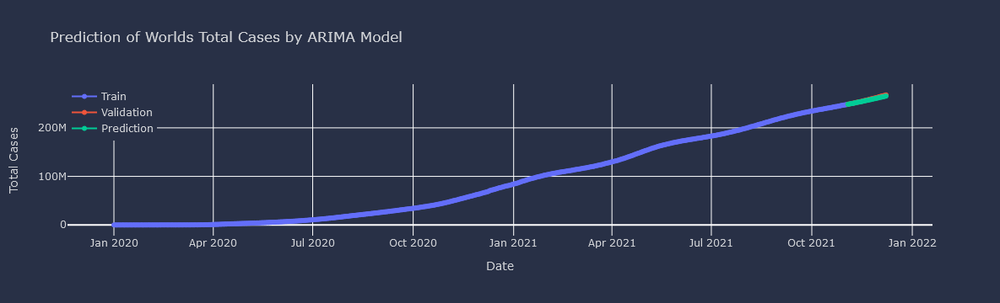

In [23]:
#Arima Model

#making anf fitting
model_arima= auto_arima(train_data['total_cases'],trace=True, error_action='ignore', start_p=1,start_q=1,max_p=3,max_q=3,
                   suppress_warnings=True,stepwise=False,seasonal=False)
model_arima.fit(train_data['total_cases'])



#prediction
valid_data['arima_pred'] = model_arima.predict(len(valid_data))

#Score
arima_score = np.sqrt(mean_squared_error(valid_data['total_cases'],valid_data['arima_pred']))
mseList =np.append(mseList, arima_score)
modelNames = np.append(modelNames, 'ARIMA')

#graph

fig_arima=go.Figure()
fig_arima.add_trace(go.Scatter(x=train_data["date"], y=train_data["total_cases"],
                    mode='lines+markers',name="Train"))
fig_arima.add_trace(go.Scatter(x=valid_data["date"], y=valid_data["total_cases"],
                    mode='lines+markers',name="Validation",))
fig_arima.add_trace(go.Scatter(x=valid_data["date"], y=valid_data["arima_pred"],
                    mode='lines+markers',name="Prediction",))
fig_arima.update_layout(title="Prediction of Worlds Total Cases by ARIMA Model",
                 xaxis_title="Date",yaxis_title="Total Cases",legend=dict(x=0,y=1,traceorder="normal"))
fig_arima.update_layout(
paper_bgcolor=colors['cahrtBackground'],
plot_bgcolor=colors['chartPaper'],
font_color=colors['text'],
title_font_color=colors['text'],
legend_title_font_color=colors['text'])

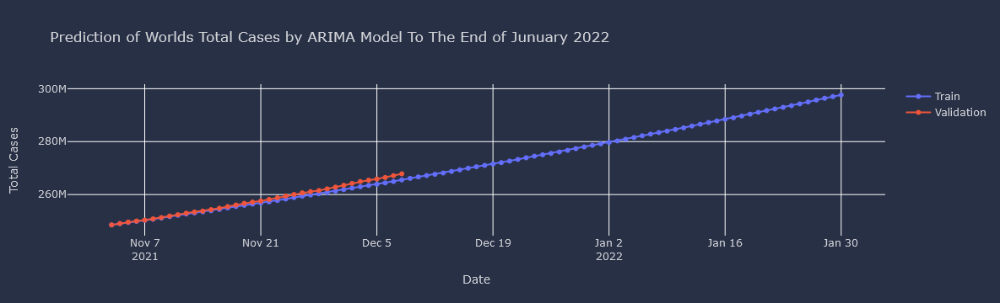

In [24]:
import datetime

start = datetime.datetime.strptime("2021-11-03", "%Y-%m-%d")
end = datetime.datetime.strptime("2022-01-31", "%Y-%m-%d")
date_generated = [start + datetime.timedelta(days=x) for x in range(0, (end-start).days)]
predict = pd.DataFrame()
predict['date'] = date_generated
predict['arima_pred'] =model_arima.predict(len(predict))

fig_arima_pred=go.Figure()
fig_arima_pred.add_trace(go.Scatter(x=predict["date"], y=predict["arima_pred"],
                    mode='lines+markers',name="Train"))
fig_arima_pred.add_trace(go.Scatter(x=valid_data["date"], y=valid_data["total_cases"],
                    mode='lines+markers',name="Validation",))
fig_arima_pred.update_layout(title="Prediction of Worlds Total Cases by ARIMA Model To The End of Junuary 2022",
                 xaxis_title="Date",yaxis_title="Total Cases")
fig_arima_pred.update_layout(
paper_bgcolor=colors['cahrtBackground'],
plot_bgcolor=colors['chartPaper'],
font_color=colors['text'],
title_font_color=colors['text'],
legend_title_font_color=colors['text'])

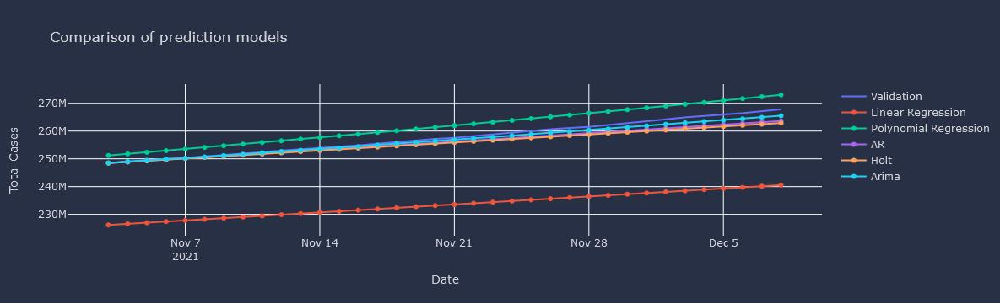

In [25]:
#All prediction validation in one chart
fig_all_pred=go.Figure()
fig_all_pred.add_trace(go.Scatter(x=valid_data["date"], y=valid_data["total_cases"],
                    mode='lines',name="Validation",))
fig_all_pred.add_trace(go.Scatter(x=valid_data["date"], y=valid_data["linear_pred"],
                    mode='lines+markers',name="Linear Regression",))
fig_all_pred.add_trace(go.Scatter(x=valid_data["date"], y=valid_data["poly_pred"],
                    mode='lines+markers',name="Polynomial Regression",))
fig_all_pred.add_trace(go.Scatter(x=valid_data["date"], y=valid_data["ar_pred"],
                    mode='lines+markers',name="AR",))
fig_all_pred.add_trace(go.Scatter(x=valid_data["date"], y=valid_data["holt_pred"],
                    mode='lines+markers',name="Holt",))
fig_all_pred.add_trace(go.Scatter(x=valid_data["date"], y=valid_data["arima_pred"],
                    mode='lines+markers',name="Arima",))
fig_all_pred.update_layout(title="Comparison of prediction models",
                 xaxis_title="Date",yaxis_title="Total Cases")
fig_all_pred.update_layout(
paper_bgcolor=colors['cahrtBackground'],
plot_bgcolor=colors['chartPaper'],
font_color=colors['text'],
title_font_color=colors['text'],
legend_title_font_color=colors['text'])

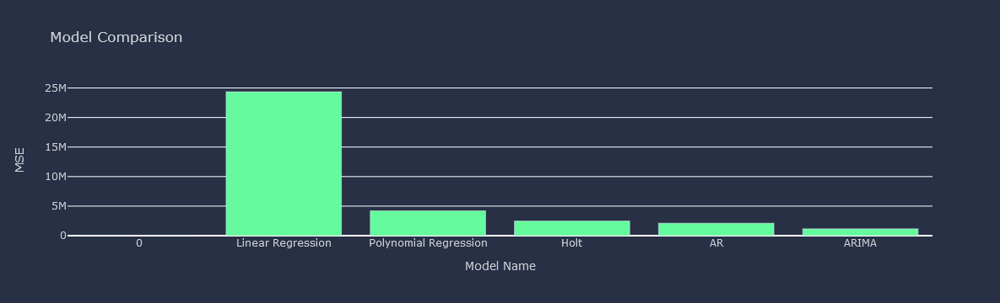

In [26]:
#All prediction comparison Bar
#Worldwide total Vaccinces
all_pred_bar=go.Figure()
all_pred_bar.add_trace(go.Bar(
    x=modelNames,
    y=mseList,
    name='Models',
    marker_color=colors['clGreen']
))
all_pred_bar.update_layout(title="Model Comparison",
                 xaxis_title="Model Name",yaxis_title="MSE")
all_pred_bar.update_layout(
paper_bgcolor=colors['cahrtBackground'],
plot_bgcolor=colors['chartPaper'],
font_color=colors['text'],
title_font_color=colors['text'],
legend_title_font_color=colors['text'])
all_pred_bar.show()

In [27]:
#Making the dash app
external_stylesheets = ['https://codepen.io/chriddyp/pen/bWLwgP.css']
app = dash.Dash(__name__, external_stylesheets=external_stylesheets)

app.layout = html.Div(style={'backgroundColor': colors['background']},children=[
    html.Div([
        html.H1(children='Covid statistics Worldwide', style = {'textAlign': 'center','color': colors['text'],'backgroundColor': colors['chartPaper']}),
        html.Div([
          dcc.Graph(id='ww_total_graph', figure=ww_t_c, clickData=None, hoverData=None,
                  config={
                      'staticPlot': False,     # True, False
                      'scrollZoom': True,      # True, False
                      'doubleClick': 'reset',  # 'reset', 'autosize' or 'reset+autosize', False
                      'showTips': False,       # True, False
                      'displayModeBar': True,  # True, False, 'hover'
                      'watermark': True,
                      # 'modeBarButtonsToAdd': ['pan2d','select2d'],
                        },
                  className='six columns'
                  ),
          dcc.Graph(id='ww_total_Vaccine', figure=ww_t_v, clickData=None, hoverData=None,
              config={
                  'staticPlot': False,     # True, False
                  'scrollZoom': True,      # True, False
                  'doubleClick': 'reset',  # 'reset', 'autosize' or 'reset+autosize', False
                  'showTips': False,       # True, False
                  'displayModeBar': True,  # True, False, 'hover'
                  'watermark': True,
                  # 'modeBarButtonsToAdd': ['pan2d','select2d'],
                    },
              className='six columns'
              )]),
    html.Div([
          dcc.Graph(id='ww_daily_graph', figure=ww_d_c, clickData=None, hoverData=None,
                  config={
                      'staticPlot': False,     # True, False
                      'scrollZoom': True,      # True, False
                      'doubleClick': 'reset',  # 'reset', 'autosize' or 'reset+autosize', False
                      'showTips': False,       # True, False
                      'displayModeBar': True,  # True, False, 'hover'
                      'watermark': True,
                      # 'modeBarButtonsToAdd': ['pan2d','select2d'],
                        },
                  className='six columns'
                  ),
          dcc.Graph(id='ww_daily_deaths_graph', figure=ww_d_d, clickData=None, hoverData=None,
          config={
              'staticPlot': False,     # True, False
              'scrollZoom': True,      # True, False
              'doubleClick': 'reset',  # 'reset', 'autosize' or 'reset+autosize', False
              'showTips': False,       # True, False
              'displayModeBar': True,  # True, False, 'hover'
              'watermark': True,
              # 'modeBarButtonsToAdd': ['pan2d','select2d'],
                },
          className='six columns'
          )]),

    ]),
    html.Div([
        html.H1(children='Total Cases on the World Map', style = {'textAlign': 'center','color': colors['text'],'backgroundColor': colors['chartPaper']}),
        dcc.Graph(id='ww_geo', figure=ww_geo_fig, clickData=None, hoverData=None,
                 config={
                      'staticPlot': False,     # True, False
                      'scrollZoom': True,      # True, False
                      'doubleClick': 'reset',  # 'reset', 'autosize' or 'reset+autosize', False
                      'showTips': False,       # True, False
                      'displayModeBar': True,  # True, False, 'hover'
                      'watermark': True,
                      # 'modeBarButtonsToAdd': ['pan2d','select2d'],
                        },
                  className='row'
            )
    ]),
    html.Div([
        html.H1(children='Covid statistics by continent', style = {'textAlign': 'center','color': colors['text'],'backgroundColor': colors['chartPaper']}),
        dcc.Graph(id='continent_total_graph', figure=pie_ww_fig, clickData=None, hoverData=None,
                  config={
                      'staticPlot': False,     # True, False
                      'scrollZoom': True,      # True, False
                      'doubleClick': 'reset',  # 'reset', 'autosize' or 'reset+autosize', False
                      'showTips': False,       # True, False
                      'displayModeBar': True,  # True, False, 'hover'
                      'watermark': True,
                      # 'modeBarButtonsToAdd': ['pan2d','select2d'],
                        },
                  className='row'
                  )
    ]),
    html.Div([
            html.H1(children='Covid statistics by country', style = {'textAlign': 'center','color': colors['text'],'backgroundColor': colors['chartPaper']}),

        html.H4(children='Select country', style = {'textAlign': 'left','color': colors['text'],'backgroundColor': colors['chartPaper']}),
            dcc.Dropdown(id='dpdn1', value=['Norway'], multi=False,
                 options=[{'label': x, 'value': x} for x in
                          df1.location.unique()],
                 style={'color':colors['chartPaper'],'background-color': colors['chartPaper']}),
        html.Div([
          dcc.Graph(id='country_total_graph', figure={}, clickData=None, hoverData=None,
                  config={
                      'staticPlot': False,     # True, False
                      'scrollZoom': True,      # True, False
                      'doubleClick': 'reset',  # 'reset', 'autosize' or 'reset+autosize', False
                      'showTips': False,       # True, False
                      'displayModeBar': True,  # True, False, 'hover'
                      'watermark': True,
                      # 'modeBarButtonsToAdd': ['pan2d','select2d'],
                        },
                  className='six columns'
                  ),
          dcc.Graph(id='country_total_Vaccine', figure={}, clickData=None, hoverData=None,
              config={
                  'staticPlot': False,     # True, False
                  'scrollZoom': True,      # True, False
                  'doubleClick': 'reset',  # 'reset', 'autosize' or 'reset+autosize', False
                  'showTips': False,       # True, False
                  'displayModeBar': True,  # True, False, 'hover'
                  'watermark': True,
                  # 'modeBarButtonsToAdd': ['pan2d','select2d'],
                    },
              className='six columns'
              )]),
    html.Div([
          dcc.Graph(id='country_daily_graph', figure={}, clickData=None, hoverData=None,
                  config={
                      'staticPlot': False,     # True, False
                      'scrollZoom': True,      # True, False
                      'doubleClick': 'reset',  # 'reset', 'autosize' or 'reset+autosize', False
                      'showTips': False,       # True, False
                      'displayModeBar': True,  # True, False, 'hover'
                      'watermark': True,
                      # 'modeBarButtonsToAdd': ['pan2d','select2d'],
                        },
                  className='six columns'
                  ),
          dcc.Graph(id='country_daily_deaths_graph', figure={}, clickData=None, hoverData=None,
          config={
              'staticPlot': False,     # True, False
              'scrollZoom': True,      # True, False
              'doubleClick': 'reset',  # 'reset', 'autosize' or 'reset+autosize', False
              'showTips': False,       # True, False
              'displayModeBar': True,  # True, False, 'hover'
              'watermark': True,
              # 'modeBarButtonsToAdd': ['pan2d','select2d'],
                },
          className='six columns'
          )])
    ]),

#Prediction charts     
    html.Div([
          html.H1(children='Total covid case predictions', style = {'textAlign': 'center','color': colors['text'],'backgroundColor': colors['chartPaper']}),
            html.Div([  
        dcc.Graph(id='linear_pred', figure=fig_ww_line_model_data, clickData=None, hoverData=None,
                  config={
                      'staticPlot': False,     # True, False
                      'scrollZoom': True,      # True, False
                      'doubleClick': 'reset',  # 'reset', 'autosize' or 'reset+autosize', False
                      'showTips': False,       # True, False
                      'displayModeBar': True,  # True, False, 'hover'
                      'watermark': True,
                      # 'modeBarButtonsToAdd': ['pan2d','select2d'],
                        },
                  className='four columns'
                  ),
          dcc.Graph(id='poly_pred', figure=fig_ww_poly_model_data, clickData=None, hoverData=None,
                  config={
                      'staticPlot': False,     # True, False
                      'scrollZoom': True,      # True, False
                      'doubleClick': 'reset',  # 'reset', 'autosize' or 'reset+autosize', False
                      'showTips': False,       # True, False
                      'displayModeBar': True,  # True, False, 'hover'
                      'watermark': True,
                      # 'modeBarButtonsToAdd': ['pan2d','select2d'],
                        },
                  className='four columns'
                  ),

          dcc.Graph(id='svm_pred', figure=fig_ww_svm, clickData=None, hoverData=None,
                  config={
                      'staticPlot': False,     # True, False
                      'scrollZoom': True,      # True, False
                      'doubleClick': 'reset',  # 'reset', 'autosize' or 'reset+autosize', False
                      'showTips': False,       # True, False
                      'displayModeBar': True,  # True, False, 'hover'
                      'watermark': True,
                      # 'modeBarButtonsToAdd': ['pan2d','select2d'],
                        },
                  className='four columns'
                  )
            ],
                className='row'),
                    html.Div([  ],className='row'),
            html.Div([  
          dcc.Graph(id='holt_pred', figure=fig_holt, clickData=None, hoverData=None,
                  config={
                      'staticPlot': False,     # True, False
                      'scrollZoom': True,      # True, False
                      'doubleClick': 'reset',  # 'reset', 'autosize' or 'reset+autosize', False
                      'showTips': False,       # True, False
                      'displayModeBar': True,  # True, False, 'hover'
                      'watermark': True,
                      # 'modeBarButtonsToAdd': ['pan2d','select2d'],
                        },
                  className='four columns'
                  ),
          dcc.Graph(id='ar_pred', figure=fig_ar, clickData=None, hoverData=None,
                  config={
                      'staticPlot': False,     # True, False
                      'scrollZoom': True,      # True, False
                      'doubleClick': 'reset',  # 'reset', 'autosize' or 'reset+autosize', False
                      'showTips': False,       # True, False
                      'displayModeBar': True,  # True, False, 'hover'
                      'watermark': True,
                      # 'modeBarButtonsToAdd': ['pan2d','select2d'],
                        },
                  className='four columns'
                  ),
          dcc.Graph(id='arima_pred', figure=fig_arima, clickData=None, hoverData=None,
                  config={
                      'staticPlot': False,     # True, False
                      'scrollZoom': True,      # True, False
                      'doubleClick': 'reset',  # 'reset', 'autosize' or 'reset+autosize', False
                      'showTips': False,       # True, False
                      'displayModeBar': True,  # True, False, 'hover'
                      'watermark': True,
                      # 'modeBarButtonsToAdd': ['pan2d','select2d'],
                        },
                  className='four columns'
                  )
            ],className='row'),
        html.Div([ 
            html.H1(children='Comparison of prediction models', style = {'textAlign': 'center','color': colors['text'],'backgroundColor': colors['chartPaper']}),
            html.Div([             
                dcc.Graph(id='pred_compare', figure=fig_all_pred, clickData=None, hoverData=None,
                  config={
                      'staticPlot': False,     # True, False
                      'scrollZoom': True,      # True, False
                      'doubleClick': 'reset',  # 'reset', 'autosize' or 'reset+autosize', False
                      'showTips': False,       # True, False
                      'displayModeBar': True,  # True, False, 'hover'
                      'watermark': True,
                      # 'modeBarButtonsToAdd': ['pan2d','select2d'],
                        },
                  className='six columns'
                  ),
                  dcc.Graph(id='pred_compare_bar', figure=all_pred_bar, clickData=None, hoverData=None,
                  config={
                      'staticPlot': False,     # True, False
                      'scrollZoom': True,      # True, False
                      'doubleClick': 'reset',  # 'reset', 'autosize' or 'reset+autosize', False
                      'showTips': False,       # True, False
                      'displayModeBar': True,  # True, False, 'hover'
                      'watermark': True,
                      # 'modeBarButtonsToAdd': ['pan2d','select2d'],
                        },
                  className='six columns'
                  )
            ])
        ])
    ]),
     html.Div([
          html.H1(children='Future Covid Prediction', style = {'textAlign': 'center','color': colors['text'],'backgroundColor': colors['chartPaper']}),
            html.Div([  
            dcc.Graph(id='future_pred', figure=fig_arima_pred, clickData=None, hoverData=None,
                  config={
                      'staticPlot': False,     # True, False
                      'scrollZoom': True,      # True, False
                      'doubleClick': 'reset',  # 'reset', 'autosize' or 'reset+autosize', False
                      'showTips': False,       # True, False
                      'displayModeBar': True,  # True, False, 'hover'
                      'watermark': True,
                      # 'modeBarButtonsToAdd': ['pan2d','select2d'],
                        },
                  className='row'
                  )
            ])
     ]),
#Correlations
            html.Div([ 
            html.H1(children='Correlation Between parameters', style = {'textAlign': 'center','color': colors['text'],'backgroundColor': colors['chartPaper']}),
            html.Div([ 
                    dcc.Graph(id='correlation', figure=fig_cor, clickData=None, hoverData=None,
                  config={
                      'staticPlot': False,     # True, False
                      'scrollZoom': True,      # True, False
                      'doubleClick': 'reset',  # 'reset', 'autosize' or 'reset+autosize', False
                      'showTips': False,       # True, False
                      'displayModeBar': True,  # True, False, 'hover'
                      'watermark': True,
                      # 'modeBarButtonsToAdd': ['pan2d','select2d'],
                        },
                  className='row'
                  )
                ])
            ]),
#Apple Mobility
        html.Div([
        html.H1(children='Reviewing Apples Moblility Datbase', style = {'textAlign': 'center','color': colors['text'],'backgroundColor': colors['chartPaper']}),
        html.Div([
          dcc.Graph(id='us_daily', figure=us_daily, clickData=None, hoverData=None,
                  config={
                      'staticPlot': False,     # True, False
                      'scrollZoom': True,      # True, False
                      'doubleClick': 'reset',  # 'reset', 'autosize' or 'reset+autosize', False
                      'showTips': False,       # True, False
                      'displayModeBar': True,  # True, False, 'hover'
                      'watermark': True,
                      # 'modeBarButtonsToAdd': ['pan2d','select2d'],
                        },
                  className='six columns'
                  ),
          dcc.Graph(id='apple_walk', figure=apple_walk, clickData=None, hoverData=None,
              config={
                  'staticPlot': False,     # True, False
                  'scrollZoom': True,      # True, False
                  'doubleClick': 'reset',  # 'reset', 'autosize' or 'reset+autosize', False
                  'showTips': False,       # True, False
                  'displayModeBar': True,  # True, False, 'hover'
                  'watermark': True,
                  # 'modeBarButtonsToAdd': ['pan2d','select2d'],
                    },
              className='six columns'
              )]),
    html.Div([
          dcc.Graph(id='apple_transit', figure=apple_transit, clickData=None, hoverData=None,
                  config={
                      'staticPlot': False,     # True, False
                      'scrollZoom': True,      # True, False
                      'doubleClick': 'reset',  # 'reset', 'autosize' or 'reset+autosize', False
                      'showTips': False,       # True, False
                      'displayModeBar': True,  # True, False, 'hover'
                      'watermark': True,
                      # 'modeBarButtonsToAdd': ['pan2d','select2d'],
                        },
                  className='six columns'
                  ),
          dcc.Graph(id='apple_drive', figure=apple_drive, clickData=None, hoverData=None,
          config={
              'staticPlot': False,     # True, False
              'scrollZoom': True,      # True, False
              'doubleClick': 'reset',  # 'reset', 'autosize' or 'reset+autosize', False
              'showTips': False,       # True, False
              'displayModeBar': True,  # True, False, 'hover'
              'watermark': True,
              # 'modeBarButtonsToAdd': ['pan2d','select2d'],
                },
          className='six columns'
          )]),

    ]),
    html.Div([
        html.H1(children='----', style = {'textAlign': 'center','color': colors['text'],'backgroundColor': colors['chartPaper']})
    ])

])

In [28]:
#Country graphs Dash

#country total
@app.callback(
    Output(component_id='country_total_graph', component_property='figure'),
    Input(component_id='dpdn1', component_property='value'),
)
def update_graph(country_chosen):
    dff = df1[df1["location"]==country_chosen]
    fig=go.Figure()
    fig.add_trace(go.Scatter(x=dff["date"], y=dff["total_cases"],
                    mode='lines+markers',name="Total cases",
                    line=dict(color=colors['clBlue'], width=4)))
    fig.update_layout(title="Total covid cases in "+country_chosen,
                 xaxis_title="Date",yaxis_title="Total Cases",legend=dict(x=0,y=1,traceorder="normal"))
    fig.update_layout(
    paper_bgcolor=colors['cahrtBackground'],
    plot_bgcolor=colors['chartPaper'],
    font_color=colors['text'],
    title_font_color=colors['text'],
    legend_title_font_color=colors['text'])
               
    return fig

#country daily
@app.callback(
    Output(component_id='country_daily_graph', component_property='figure'),
    Input(component_id='dpdn1', component_property='value'),
)
def update_graph(country_chosen):
    dff = df1[df1["location"]==country_chosen]
    fig=go.Figure()
    fig.add_trace(go.Bar(
    x=dff["date"],
    y=dff["new_cases"],
    name='New Cases',
    marker_color=colors['clOrange']
    ))
    fig.update_layout(title="Daily new Covid cases in "+country_chosen,
                 xaxis_title="Date",yaxis_title="Daily cases")
    fig.update_layout(
    paper_bgcolor=colors['cahrtBackground'],
    plot_bgcolor=colors['chartPaper'],
    font_color=colors['text'],
    title_font_color=colors['text'],
    legend_title_font_color=colors['text'])
    return fig

#country daily deaths
@app.callback(
    Output(component_id='country_daily_deaths_graph', component_property='figure'),
    Input(component_id='dpdn1', component_property='value'),
)
def update_graph(country_chosen):
    dff = df1[df1["location"]==country_chosen]
    fig=go.Figure()
    fig.add_trace(go.Bar(
    x=dff["date"],
    y=dff["new_deaths"],
    name='New deaths',
    marker_color=colors['clRed']
    ))
    fig.update_layout(title="Daily new Covid deaths in " +country_chosen,
                 xaxis_title="Date",yaxis_title="Daily deaths")
    fig.update_layout(
    paper_bgcolor=colors['cahrtBackground'],
    plot_bgcolor=colors['chartPaper'],
    font_color=colors['text'],
    title_font_color=colors['text'],
    legend_title_font_color=colors['text'])
    return fig
 #country total Vaccinces
@app.callback(
    Output(component_id='country_total_Vaccine', component_property='figure'),
    Input(component_id='dpdn1', component_property='value'),
)
def update_graph(country_chosen):
    dff = df1[df1["location"]==country_chosen]
    fig=go.Figure()
    fig.add_trace(go.Bar(
    x=dff["date"],
    y=dff["total_vaccinations"],
    name='Total vaccine',
    marker_color=colors['clGreen']
    ))
    fig.update_layout(title="Total vaccination in " +country_chosen,
                 xaxis_title="Date",yaxis_title="Daily deaths")
    fig.update_layout(
    paper_bgcolor=colors['cahrtBackground'],
    plot_bgcolor=colors['chartPaper'],
    font_color=colors['text'],
    title_font_color=colors['text'],
    legend_title_font_color=colors['text'])
    return fig


In [ ]:
#Run Dash App
if __name__ == '__main__':
    app.run_server(debug=False)

Dash is running on http://127.0.0.1:8050/

 * Serving Flask app "__main__" (lazy loading)
 * Environment: production
   Use a production WSGI server instead.
 * Debug mode: off


 * Running on http://127.0.0.1:8050/ (Press CTRL+C to quit)
127.0.0.1 - - [10/Dec/2021 03:53:45] "GET / HTTP/1.1" 200 -
127.0.0.1 - - [10/Dec/2021 03:53:46] "GET /_dash-layout HTTP/1.1" 200 -
127.0.0.1 - - [10/Dec/2021 03:53:46] "GET /_dash-dependencies HTTP/1.1" 200 -
127.0.0.1 - - [10/Dec/2021 03:53:46] "GET /_favicon.ico?v=2.0.0 HTTP/1.1" 200 -
127.0.0.1 - - [10/Dec/2021 03:53:46] "GET /_dash-component-suites/dash/dcc/async-graph.js HTTP/1.1" 304 -
127.0.0.1 - - [10/Dec/2021 03:53:46] "GET /_dash-component-suites/dash/dcc/async-dropdown.js HTTP/1.1" 304 -
127.0.0.1 - - [10/Dec/2021 03:53:46] "GET /_dash-component-suites/dash/dcc/async-plotlyjs.js HTTP/1.1" 304 -


Exception on /_dash-update-component [POST]
Traceback (most recent call last):
  File "C:\Users\ramin\anaconda3\lib\site-packages\flask\app.py", line 2447, in wsgi_app
    response = self.full_dispatch_request()
  File "C:\Users\ramin\anaconda3\lib\site-packages\flask\app.py", line 1952, in full_dispatch_request
    rv = self.handle_user_exception(e)
  File "C:\Users\ramin\anaconda3\lib\site-packages\flask\app.py", line 1821, in handle_user_exception
    reraise(exc_type, exc_value, tb)
  File "C:\Users\ramin\anaconda3\lib\site-packages\flask\_compat.py", line 39, in reraise
    raise value
  File "C:\Users\ramin\anaconda3\lib\site-packages\flask\app.py", line 1950, in full_dispatch_request
    rv = self.dispatch_request()
  File "C:\Users\ramin\anaconda3\lib\site-packages\flask\app.py", line 1936, in dispatch_request
    return self.view_functions[rule.endpoint](**req.view_args)
  File "C:\Users\ramin\anaconda3\lib\site-packages\dash\dash.py", line 1336, in dispatch
    response.set_d

127.0.0.1 - - [10/Dec/2021 03:53:46] "POST /_dash-update-component HTTP/1.1" 500 -


Exception on /_dash-update-component [POST]
Traceback (most recent call last):
  File "C:\Users\ramin\anaconda3\lib\site-packages\flask\app.py", line 2447, in wsgi_app
    response = self.full_dispatch_request()
  File "C:\Users\ramin\anaconda3\lib\site-packages\flask\app.py", line 1952, in full_dispatch_request
    rv = self.handle_user_exception(e)
  File "C:\Users\ramin\anaconda3\lib\site-packages\flask\app.py", line 1821, in handle_user_exception
    reraise(exc_type, exc_value, tb)
  File "C:\Users\ramin\anaconda3\lib\site-packages\flask\_compat.py", line 39, in reraise
    raise value
  File "C:\Users\ramin\anaconda3\lib\site-packages\flask\app.py", line 1950, in full_dispatch_request
    rv = self.dispatch_request()
  File "C:\Users\ramin\anaconda3\lib\site-packages\flask\app.py", line 1936, in dispatch_request
    return self.view_functions[rule.endpoint](**req.view_args)
  File "C:\Users\ramin\anaconda3\lib\site-packages\dash\dash.py", line 1336, in dispatch
    response.set_d

127.0.0.1 - - [10/Dec/2021 03:53:46] "POST /_dash-update-component HTTP/1.1" 500 -


Exception on /_dash-update-component [POST]
Traceback (most recent call last):
  File "C:\Users\ramin\anaconda3\lib\site-packages\flask\app.py", line 2447, in wsgi_app
    response = self.full_dispatch_request()
  File "C:\Users\ramin\anaconda3\lib\site-packages\flask\app.py", line 1952, in full_dispatch_request
    rv = self.handle_user_exception(e)
  File "C:\Users\ramin\anaconda3\lib\site-packages\flask\app.py", line 1821, in handle_user_exception
    reraise(exc_type, exc_value, tb)
  File "C:\Users\ramin\anaconda3\lib\site-packages\flask\_compat.py", line 39, in reraise
    raise value
  File "C:\Users\ramin\anaconda3\lib\site-packages\flask\app.py", line 1950, in full_dispatch_request
    rv = self.dispatch_request()
  File "C:\Users\ramin\anaconda3\lib\site-packages\flask\app.py", line 1936, in dispatch_request
    return self.view_functions[rule.endpoint](**req.view_args)
  File "C:\Users\ramin\anaconda3\lib\site-packages\dash\dash.py", line 1336, in dispatch
    response.set_d

127.0.0.1 - - [10/Dec/2021 03:53:46] "POST /_dash-update-component HTTP/1.1" 500 -


Exception on /_dash-update-component [POST]
Traceback (most recent call last):
  File "C:\Users\ramin\anaconda3\lib\site-packages\flask\app.py", line 2447, in wsgi_app
    response = self.full_dispatch_request()
  File "C:\Users\ramin\anaconda3\lib\site-packages\flask\app.py", line 1952, in full_dispatch_request
    rv = self.handle_user_exception(e)
  File "C:\Users\ramin\anaconda3\lib\site-packages\flask\app.py", line 1821, in handle_user_exception
    reraise(exc_type, exc_value, tb)
  File "C:\Users\ramin\anaconda3\lib\site-packages\flask\_compat.py", line 39, in reraise
    raise value
  File "C:\Users\ramin\anaconda3\lib\site-packages\flask\app.py", line 1950, in full_dispatch_request
    rv = self.dispatch_request()
  File "C:\Users\ramin\anaconda3\lib\site-packages\flask\app.py", line 1936, in dispatch_request
    return self.view_functions[rule.endpoint](**req.view_args)
  File "C:\Users\ramin\anaconda3\lib\site-packages\dash\dash.py", line 1336, in dispatch
    response.set_d

127.0.0.1 - - [10/Dec/2021 03:53:46] "POST /_dash-update-component HTTP/1.1" 500 -
127.0.0.1 - - [10/Dec/2021 03:54:07] "POST /_dash-update-component HTTP/1.1" 200 -
127.0.0.1 - - [10/Dec/2021 03:54:07] "POST /_dash-update-component HTTP/1.1" 200 -
127.0.0.1 - - [10/Dec/2021 03:54:07] "POST /_dash-update-component HTTP/1.1" 200 -
127.0.0.1 - - [10/Dec/2021 03:54:07] "POST /_dash-update-component HTTP/1.1" 200 -
